In [1]:
import cv2
import pandas as pd
from PIL import Image
%matplotlib inline
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('png')
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import os
from glob import glob

In [2]:
full_labels_1 = pd.read_csv('../annotations/Train_fish/Fish_1_labels.csv')
full_labels_2 = pd.read_csv('../annotations/Train_fish/Fish_2_labels.csv')
full_labels_3 = pd.read_csv('../annotations/Train_fish/Fish_3_labels.csv')
full_labels_4 = pd.read_csv('../annotations/Train_fish/Fish_4_labels.csv')
full_labels_5 = pd.read_csv('../annotations/Train_fish/Fish_5_labels.csv')
full_labels_6 = pd.read_csv('../annotations/Train_fish/Fish_6_labels.csv')

In [5]:
full_labels_1.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,Basler acA4112-8gc (40003213)_20180326_1348012...,4096,3000,Fish_1,3023,1000,4096,2042
1,Basler acA4112-8gc (40003213)_20180326_1348012...,4096,3000,Fish_1,2591,725,4096,2192
2,Basler acA4112-8gc (40003213)_20180326_1348012...,4096,3000,Fish_1,2223,750,4096,2360
3,Basler acA4112-8gc (40003213)_20180326_1348012...,4096,3000,Fish_1,1960,750,4096,2632
4,Basler acA4112-8gc (40003213)_20180326_1348012...,4096,3000,Fish_1,1673,1125,4096,2910


In [165]:
def draw_boxes(image_name):
    selected_value = full_labels_1[full_labels_1.filename == image_name]
    img = cv2.imread('/Users/sonali/Documents/insight/rohandata/Train_Fish/Fish_1/{}'.format(image_name))
    for index, row in selected_value.iterrows():
        img = PIL.ImageDraw.Draw.rectangle(img, (row['xmin'], row['ymin']), (row['xmax'], row['ymax']), (0, 255, 0), 3)
    return img

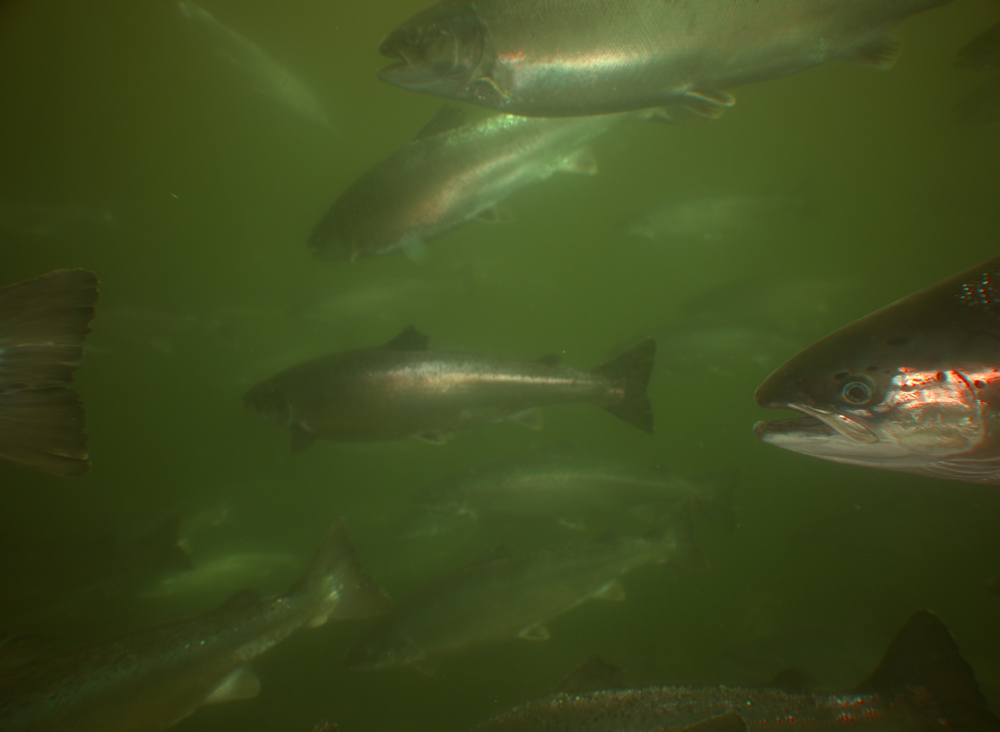

In [167]:
Image.fromarray(draw_boxes('Basler acA4112-8gc (40003213)_20180326_134801204_0240-Copy1.jpg'))

In [210]:
image_name = 'Basler acA4112-8gc (40003213)_20180326_134801204_0240-Copy1.png'
selected_value = full_labels_1[full_labels_1.filename =='Basler acA4112-8gc (40003213)_20180326_134801204_0240-Copy1.png']


In [230]:
os.path.basename(f)


'Basler acA4112-8gc (40003213)_20180326_134801204_0256-Copy1.jpg'

In [206]:
print selected_value
x = selected_value.iloc[0]['xmin']
print x

                                            filename  width  height   class  \
0  Basler acA4112-8gc (40003213)_20180326_1348012...   4096    3000  Fish_1   

   xmin  ymin  xmax  ymax  
0  3023  1000  4096  2042  
3023


In [46]:
img = cv2.imread('/Users/sonali/Documents/insight/rohandata/Train_Fish/Fish_1/{}'.format(image_name))

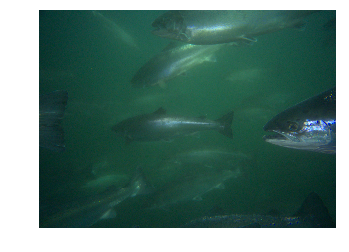

In [129]:
img_pil = Image.open('/Users/sonali/Documents/insight/rohandata/Train_Fish/Fish_1/Basler acA4112-8gc (40003213)_20180326_134801204_0240-Copy1.png') # make sure data dir is correct
plt.axis('off')
plt.imshow(img_pil)
plt.show()

In [130]:
draw = ImageDraw.Draw(img_pil)
xmin = 3023
ymin = 1000
xmax = 4096
ymax = 2042

In [139]:
draw.rectangle(((3023, 1000), (4096, 2042)),fill=None, outline="red")

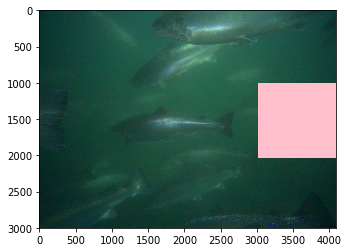

In [140]:
plt.imshow(img_pil)

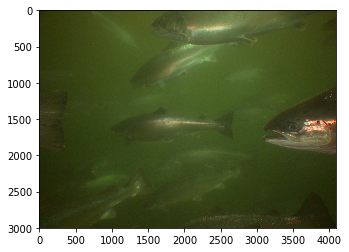

In [118]:
img_pil = cv2.imread('/Users/sonali/Documents/insight/rohandata/Train_Fish/Fish_1/Basler acA4112-8gc (40003213)_20180326_134801204_0240-Copy1.png')
cv2.rectangle(img_pil,(3023, 1000),(4096, 2042),color=(255, 255, 255))
plt.imshow(img_pil)

In [284]:
####------repeat this for all fish--------
ROOT_DIR = os.path.dirname('/Users/sonali/Documents/insight/') 
DATA_HOME_DIR = ROOT_DIR + '/data_crop/'

source_path = DATA_HOME_DIR+"train_full/"
export_path = DATA_HOME_DIR+'train_crop/Fish_2/'

crop_width = 2900

anno_classes = ['Fish_1', 'Fish_2', 'Fish_3', 'Fish_4', 'Fish_5', 'Fish_6', 'Fish_7']


In [279]:
os.listdir(source_path)
print (export_path)
print (source_path)

/Users/sonali/Documents/insight/data_crop/train_crop/Fish_1/
/Users/sonali/Documents/insight/data_crop/train_full/


In [285]:
for folder in glob(os.path.join(source_path, '*')):
     #print (folder)
    if (folder == source_path+"Fish_2"):       
        for f in glob(os.path.join(folder, '*.png')):
            img = cv2.imread(f)
            img_width = img.shape[1]
            img_height = img.shape[0]            
            selected_value = full_labels_2[full_labels_2.filename == os.path.basename(f)]
            
            x = selected_value.iloc[0]['xmin'] #bottom left
            y = selected_value.iloc[0]['ymin']
            x_max = selected_value.iloc[0]['xmax'] #bottom left
            y_max = selected_value.iloc[0]['ymax']
            width = x_max - x
            height = y_max - y
            cX = x + width/2
            cY = y + height/2
        #calculate boundries of bounding box (overriding x,y to make bbox bigger)
            x = max(cX - crop_width/2, 0)
            y = max(cY - crop_width/2, 0)
      
            if x + crop_width > img_width:
                x = img_width - crop_width
            if y + crop_width > img_height:
                y = img_height - crop_width

        
            x = int(x)
            y = int(y)
            crop_img = img[y:y+crop_width, x:x+crop_width]        
            foldername = folder.split('/')[-1]
            filename = f.split('/')[-1]

            cv2.imwrite(export_path+filename,crop_img)    

In [212]:
os.path.basename('/Users/sonali/Documents/insight/data_crop/train_full/Fish_1/')

'Fish_1'